# Overview

This week we'll talk about advanced network measures (beyond the degree distribution). We will use these tools to make sense of the network of the Rock Musicians on Wikipedia. 
This is the outline for today:

* Visualization and qualitative analysis of the Rock Music Artists Network
* Properties of the network structure
* Finally some more visualizations

> _Reading_: This week, the reading is mostly for reference. It's for you to have a place to go, if you want more detailed information about the topics that I cover in the video lectures. Thus, I recommend you check out **Chapter 9** of the network science book. In particular, we'll delve into Section 9.4 in the exercises below. We will also talk a little bit about degree correlations - you can read about those in **Chapter 7**.

# Part A: Let's  visualise some more!

For the rest of the course, we will primarily use[`ForceAtlas2`](https://journals.plos.org/plosone/article%3Fid=10.1371/journal.pone.0098679), a layout algorithm which was developed by the creators of the [Gephy graph analysis software](https://gephi.org). IMHO it's the prettiest network layout algorithm & since last year it's been implemented in NetworkX, so it should be easy to use.

*Exercise 1:* Plot the Network using ForceAtlas2. For visualization, you should work with the network from last time, the Giant Connected Component ... and the undirected version.

> * Visualize the network using NetworkX
>   * Node color should depend on the `length_of_content` attribute (see notes from last week).
>   * Node size should depend on the node *degree*
> * Play with the force atlas algorithm parameters to obtain a visualization you like. 

<div class="alert alert-block alert-info">
It's OK to use your LLM as much as needed for this exercise. The only goal is to create a nice visualization.
</div>

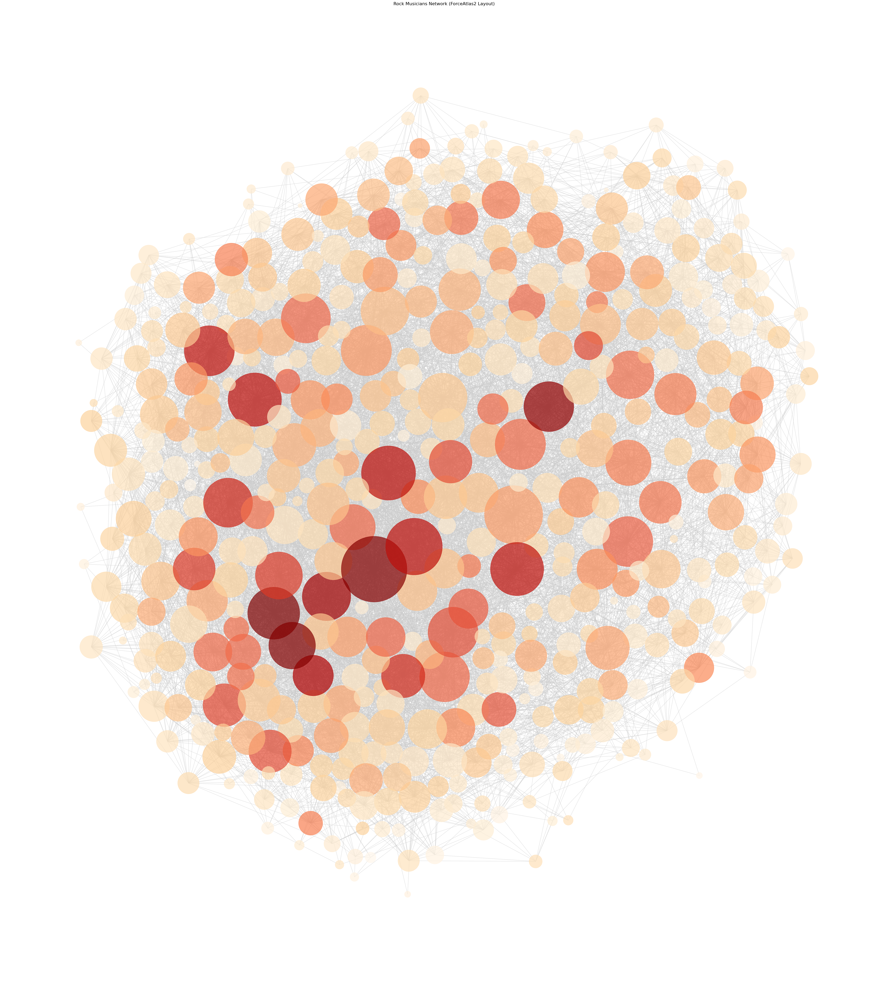

In [1]:
import networkx as nx
from networkx import forceatlas2_layout
import matplotlib.pyplot as plt

G = nx.read_gexf("../Week4/rock_performers_graph.gexf")
G_undirected = G.to_undirected()

node_colors = [G_undirected.nodes[n].get('word_count', 0) for n in G_undirected.nodes()]
node_sizes = [G_undirected.degree(n)*250 for n in G_undirected.nodes()]

pos = forceatlas2_layout(G_undirected, 
                         pos=None, 
                         max_iter=2000, 
                         gravity=0.3, 
                         strong_gravity=True, 
                         jitter_tolerance=0.5,
                         seed=42)

fig, ax = plt.subplots(figsize=(50,50))

nx.draw_networkx(
    G_undirected, pos=pos,
    node_color=node_colors,
    node_size=node_sizes,
    cmap=plt.cm.OrRd,  # Matplotlib colormap
    with_labels=False,
    edge_color='#CCCCCC',
    alpha=0.7,
    ax=ax
)

ax.set_aspect('equal')
ax.axis('off')

plt.title("Rock Musicians Network (ForceAtlas2 Layout)", fontsize=16, pad=20)
plt.tight_layout()
plt.show()

*Exercise 2*: We continue with a qualitative inspection of the Wikipedia pages. Inspecting the data manually will develop intuitions that will help us to intepret our quantitative results. We investigate the reasons for links between characters to exist on Wikipedia.

> 1. Consider the nodes with highest in-degree in the network. Open the corresponding Wikipedia page.
>    * Consider the set of neighbours pointing towards the node found above. 
>    * What is the relation between the band/mucisians you identified and their network neighbours? (e.g. did they sing a song together, did one write a song for the other?, etc ...). You don't need to come up with a grand theory of Rock Music here, I just want you to think about how links arise, why the links are there.
>    * Repeat the exercise for the highest out-degree node. 
>    * Are there differences between reasons for out- and in-links? Again, there's no right answer here. I just want you to think about some of the reasons why links may occur in Wikipedia. Answer in your own words.
> 4. Create a scatter plot, where each node is a point, and the axes show in- versus out-degree. That way you can visually inspect the patterns of how in- and out-degree are connected across all the nodes in the network. Comment on what you see.
> 5. Are there any nodes with high(ish) out-degree and with few incoming connections? If yes, open WikiPages of those bands/mucisians and explain what happens?
> 6. Are there any nodes with high in-degree and few going connections? Again, open the WikiPages corresponding to those nodes and explain what happens?

<div class="alert alert-block alert-info">
For this one, I hope you'll limit your LLM use. It's OK to get help in creating the scatter plot, but use NetworkX on your own to identify nodes, and do your own reading and interpreting of Wiki pages.
</div>

In [2]:
highest_in_degree_node = max(G.in_degree, key=lambda x: x[1])
print(f"Node with highest in-degree: {highest_in_degree_node[0]} (In-Degree: {highest_in_degree_node[1]})")
highest_out_degree_node = max(G.out_degree, key=lambda x: x[1])
print(f"Node with highest out-degree: {highest_out_degree_node[0]} (Out-Degree: {highest_out_degree_node[1]})")

Node with highest in-degree: The_Beatles (In-Degree: 219)
Node with highest out-degree: The_Beatles (Out-Degree: 124)


In [3]:
# Access highest in-degree and out-degree nodes neighbours
in_degree_neighbours = list(G.predecessors(highest_in_degree_node[0]))
out_degree_neighbours = list(G.successors(highest_out_degree_node[0]))  
print(f"Neighbours of node with highest in-degree ({highest_in_degree_node[0]}): {in_degree_neighbours}")
print(f"Neighbours of node with highest out-degree ({highest_out_degree_node[0]}): {out_degree_neighbours}")

Neighbours of node with highest in-degree (The_Beatles): ['The_Dave_Clark_Five', 'Keane_(band)', 'Joe_Walsh', 'Roxy_Music', 'Awolnation', '10cc', 'Eric_Clapton', 'Kiss_(band)', 'Pearl_Jam', 'Jack_White', 'Alanis_Morissette', 'Korn', 'Peter_Frampton', 'Dire_Straits', 'Linkin_Park', 'The_Moody_Blues', 'Black_Sabbath', 'Our_Lady_Peace', 'Asia_(band)', 'The_Hollies', 'Styx_(band)', 'Small_Faces', 'Ozzy_Osbourne', 'Chubby_Checker', 'Elton_John', 'Def_Leppard', 'The_Cure', 'Ringo_Starr', 'Staind', 'Snow_Patrol', 'Talking_Heads', 'Breaking_Benjamin', 'The_Smashing_Pumpkins', 'Harry_Nilsson', 'Bob_Dylan', 'Peter_Gabriel', 'Tenacious_D', 'John_Lennon', 'Avenged_Sevenfold', 'Bee_Gees', 'Donovan', 'Pixies_(band)', 'Gary_Glitter', 'The_Four_Seasons_(band)', 'Tracy_Chapman', 'Anthrax_(American_band)', 'Dashboard_Confessional', 'Grateful_Dead', 'The_Who', 'Fun_(band)', 'Linda_Ronstadt', 'Paul_McCartney_and_Wings', 'Imagine_Dragons', 'Trivium_(band)', 'The_Outfield', 'Bruce_Springsteen', 'Coldplay', 

**2.1**
* In-links = Beatles → legacy (who they influenced, who referenced them)
* Out-links = Beatles → heritage (who influenced them, who they worked with at the time)

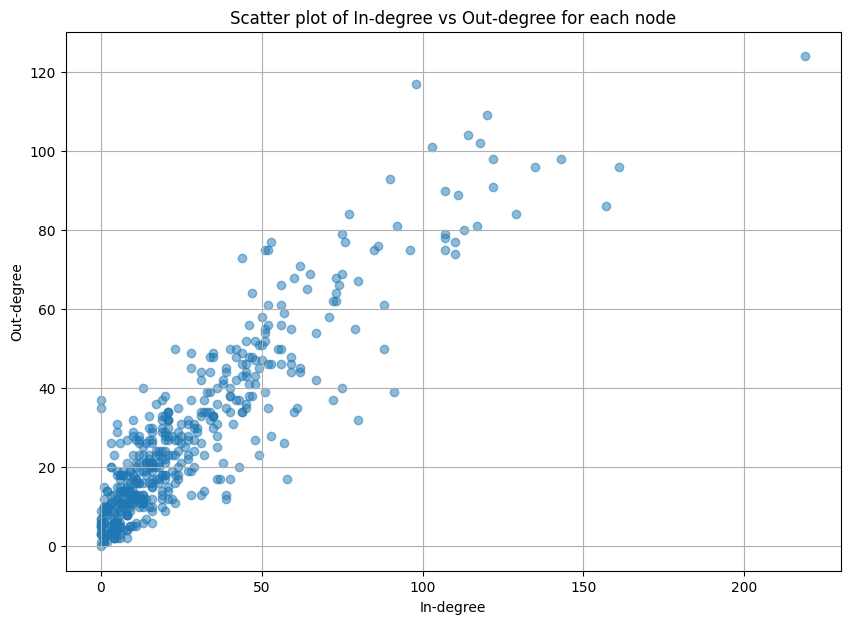

In [4]:
in_degrees = [G.in_degree(n) for n in G.nodes()]
out_degrees = [G.out_degree(n) for n in G.nodes()]

plt.figure(figsize=(10, 7))
plt.scatter(in_degrees, out_degrees, alpha=0.5)
plt.xlabel("In-degree")
plt.ylabel("Out-degree")
plt.title("Scatter plot of In-degree vs Out-degree for each node")
plt.grid(True)
plt.show()

In [5]:
import numpy as np

# Get degree distributions
out_degrees = np.array([G.out_degree(n) for n in G.nodes()])
in_degrees = np.array([G.in_degree(n) for n in G.nodes()])

# Calculate statistical thresholds using mean + standard deviations
# Adjust the multiplier (1.5, 2, etc.) to be more or less strict
std_multiplier = 1.0  # Start with 1 std dev

out_degree_high = out_degrees.mean() + std_multiplier * out_degrees.std()
out_degree_low = out_degrees.mean() - std_multiplier * out_degrees.std()
in_degree_high = in_degrees.mean() + std_multiplier * in_degrees.std()
in_degree_low = in_degrees.mean() - std_multiplier * in_degrees.std()

# Ensure low thresholds don't go negative
out_degree_low = max(0, out_degree_low)
in_degree_low = max(0, in_degree_low)

print(f"Statistical thresholds (mean ± {std_multiplier} std):")
print(f"Out-degree: low={out_degree_low:.1f}, high={out_degree_high:.1f}")
print(f"In-degree: low={in_degree_low:.1f}, high={in_degree_high:.1f}")
print()

# Distribution statistics
print(f"Distribution statistics:")
print(f"Out-degree - mean: {out_degrees.mean():.1f}, std: {out_degrees.std():.1f}, median: {np.median(out_degrees):.1f}")
print(f"In-degree - mean: {in_degrees.mean():.1f}, std: {in_degrees.std():.1f}, median: {np.median(in_degrees):.1f}")
print()

# Find nodes with high out-degree and low in-degree
high_out_low_in = [
    n for n in G.nodes()
    if G.out_degree(n) >= out_degree_high and G.in_degree(n) <= in_degree_low
]

print(f"Nodes with high out-degree and low in-degree: ({len(high_out_low_in)} found)")
for n in high_out_low_in:
    print(f"{n}: out-degree={G.out_degree(n)}, in-degree={G.in_degree(n)}")

# Find nodes with high in-degree and low out-degree
high_in_low_out = [
    n for n in G.nodes()
    if G.in_degree(n) >= in_degree_high and G.out_degree(n) <= out_degree_low
]

print(f"\nNodes with high in-degree and low out-degree: ({len(high_in_low_out)} found)")
for n in high_in_low_out:
    print(f"{n}: in-degree={G.in_degree(n)}, out-degree={G.out_degree(n)}")

# If still empty, show top candidates
if not high_out_low_in:
    print("\nNo exact matches. Top 5 candidates (highest out-degree / in-degree ratio):")
    ratios = [(n, G.out_degree(n) / max(1, G.in_degree(n)), G.out_degree(n), G.in_degree(n)) 
              for n in G.nodes()]
    ratios.sort(key=lambda x: x[1], reverse=True)
    for n, ratio, out_d, in_d in ratios[:5]:
        print(f"{n}: out={out_d}, in={in_d}, ratio={ratio:.2f}")

if not high_in_low_out:
    print("\nNo exact matches. Top 5 candidates (highest in-degree / out-degree ratio):")
    ratios = [(n, G.in_degree(n) / max(1, G.out_degree(n)), G.in_degree(n), G.out_degree(n)) 
              for n in G.nodes()]
    ratios.sort(key=lambda x: x[1], reverse=True)
    for n, ratio, in_d, out_d in ratios[:5]:
        print(f"{n}: in={in_d}, out={out_d}, ratio={ratio:.2f}")

Statistical thresholds (mean ± 1.0 std):
Out-degree: low=5.5, high=50.9
In-degree: low=0.0, high=58.1

Distribution statistics:
Out-degree - mean: 28.2, std: 22.7, median: 21.0
In-degree - mean: 28.2, std: 29.9, median: 18.0

Nodes with high out-degree and low in-degree: (0 found)

Nodes with high in-degree and low out-degree: (0 found)

No exact matches. Top 5 candidates (highest out-degree / in-degree ratio):
DC: out=37, in=0, ratio=37.00
Jet_(Australian_band): out=35, in=0, ratio=35.00
Smash_Mouth: out=15, in=1, ratio=15.00
Awolnation: out=12, in=1, ratio=12.00
The_Outfield: out=10, in=1, ratio=10.00

No exact matches. Top 5 candidates (highest in-degree / out-degree ratio):
Goo_Goo_Dolls: in=8, out=2, ratio=4.00
Cream_(band): in=58, out=17, ratio=3.41
Jerry_Lee_Lewis: in=39, out=12, ratio=3.25
The_Marshall_Tucker_Band: in=6, out=2, ratio=3.00
Run-DMC: in=39, out=13, ratio=3.00


# Part B:  Advanced tools 

> **Video lecture**: *Network measures*. There's an updated video below, and if you can't get enough, you can watch the original version from 2015 [here](https://www.youtube.com/watch?v=0uAYpOqVHCU).

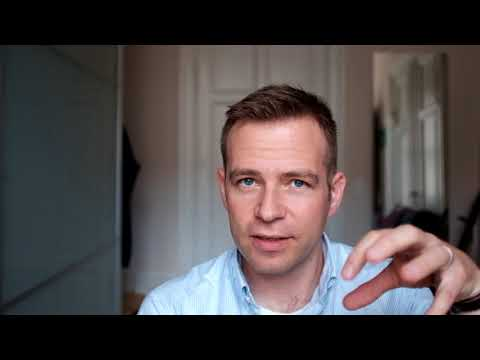

In [6]:
from IPython.display import YouTubeVideo
YouTubeVideo("IOWXZFOyk9Y", width=800, height=450)

*Exercise 3:* Last time we visually analyzed (plotted) the degree distributions of our network. Now, let's analyze it using some of the tools from previous lectures. For this exercise we are going to look at the *directed* graph (rememeber, we asked you to keep one?).

> 1. What are the average, median, mode, minimum and maximum value of the in-degree? And of the out-degree? How do you intepret the results?
> 2. Let's also look at the *[exponent of the degree distribution](http://networksciencebook.com/chapter/4#degree-exponent)* 
>    * To calculate it, you can install [`powerlaw`](https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0085777) package (I could not install in conda, so I used `pip install powerlaw`)
>    * Use `powerlaw.Fit(degree).alpha` for fitting
>    * Find the degree exponent for in-, out- and total- degree distribution. Think about what you learned in the book - what does each exponent say about our network?
>    * When analyzing the plots of in- and out- degree distribution last week, did you come up to the same conclusions?
>    * Reflect on the whole power-law thing. Are the degree distributions even power laws? Could a log-normal or exponential distribution be better? How would you find out what the right function to describe the various degree distributions are? 
>    * A long time ago, a group of scientists analyzed the network spanned by **all** of Wikipedia (the paper is called [Wikipedias: Collaborative web-based encyclopedias as complex networks](https://journals.aps.org/pre/abstract/10.1103/PhysRevE.74.016115); to access this paper, use findit.dtu.dk or read the preprint on [arXiv](https://arxiv.org/abs/physics/0602149)). Do your findings correspond to the results described in Chapter **III.A** of that paper? If not, try to give your explanation of why? 
> 3. Plot a heatmap [(Hint here)](https://stackoverflow.com/questions/2369492/generate-a-heatmap-in-matplotlib-using-a-scatter-data-set) of the the in- versus out- degree for all characters. Zoom in on just the in-degree $[0,20]$ and out-degree $[0,20]$ area of the plot. What is the advantage of using a heatmap over the scatter plot from the previous Exercise (especially for understanding what's going on in this area)?
> 4. Why do you think I want you guys to use a directed graph? Are there questions we can ask using the directed graph that are not possible to answer in the undirected version? Which questions? Can you think of examples when the in/out distinction doesn't matter.
> 5. We have one more metric that we have used, but not investigated so far. The node-attribute `length_of_content`. There are two things to look at.
>    * Firstly, we can verify that more text means more links. If that's true the length should correlate with out-degree. Does it? 
>    * Secondly, and more interestingly, it could be that longer texts means *more famous* characters. And that means more in-links. 
>    * How should you test this? Well, here you are allowed to be **creative**. You may choose the method of your liking to study this question (e.g. look at it visually, test the correlation using [spearman](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.spearmanr.html) or [pearson](https://docs.scipy.org/doc/scipy-0.14.0/reference/generated/scipy.stats.pearsonr.html) correlations, fit a curve to the data, you decide). Are both questions true? If yes, which phenomenon is stronger? Explain your results in your own words.

<div class="alert alert-block alert-info">
For this exercise, I also hope you'll limit your LLM use. Especially for the intrepretation parts. It's OK to get help for the heatmap in sub-part 3, maybe also for ideas of how to do the testing in part 5. But do your own interpretation :)
</div>

In [7]:
# 3.1 Average, median, mode, min, max of in-degrees and out-degrees
import numpy as np
import scipy.stats as stats

# Get in-degrees and out-degrees
in_degrees = [G.in_degree(n) for n in G.nodes()]
out_degrees = [G.out_degree(n) for n in G.nodes()]

print("In-Degree Statistics:")
print(f"Average: {np.mean(in_degrees):.2f}")
print(f"Median: {np.median(in_degrees):.2f}")
print(f"Mode: {int(stats.mode(in_degrees).mode)} (Count: {int(stats.mode(in_degrees).count)})")
print(f"Min: {np.min(in_degrees)}")
print(f"Max: {np.max(in_degrees)}")
print()
print("Out-Degree Statistics:")
print(f"Average: {np.mean(out_degrees):.2f}")
print(f"Median: {np.median(out_degrees):.2f}")
print(f"Mode: {int(stats.mode(out_degrees).mode)} (Count: {int(stats.mode(out_degrees).count)})")
print(f"Min: {np.min(out_degrees)}")
print(f"Max: {np.max(out_degrees)}")

In-Degree Statistics:
Average: 28.19
Median: 18.00
Mode: 1 (Count: 18)
Min: 0
Max: 219

Out-Degree Statistics:
Average: 28.19
Median: 21.00
Mode: 11 (Count: 18)
Min: 0
Max: 124


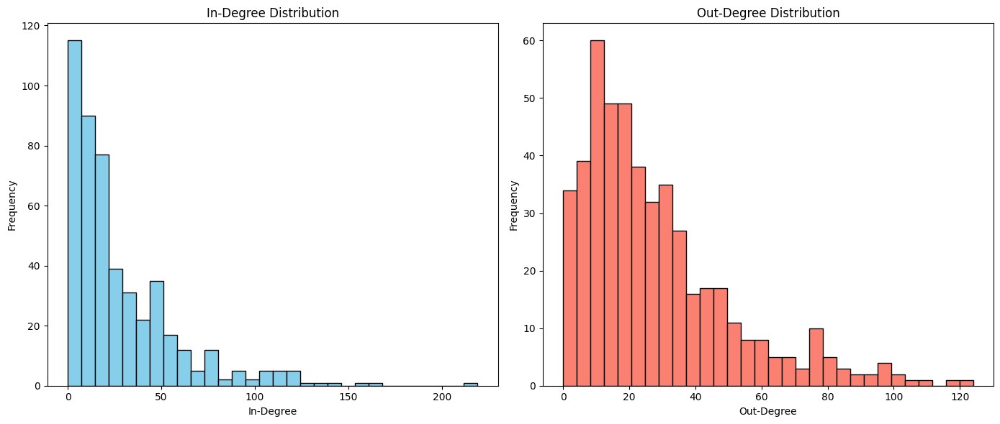

In [8]:
# plot degree distributions
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
plt.hist(in_degrees, bins=30, color='skyblue', edgecolor='black')
plt.title('In-Degree Distribution')
plt.xlabel('In-Degree')
plt.ylabel('Frequency') 
plt.subplot(1, 2, 2)
plt.hist(out_degrees, bins=30, color='salmon', edgecolor='black')
plt.title('Out-Degree Distribution')
plt.xlabel('Out-Degree')
plt.ylabel('Frequency') 
plt.tight_layout()
plt.show()

Calculating best minimal value for power law fit
Calculating best minimal value for power law fit
In-Degree Power-Law alpha: 3.19, xmin: 42.0
Out-Degree Power-Law alpha: 6.69, xmin: 73.0


Values less than or equal to 0 in data. Throwing out 0 or negative values
Values less than or equal to 0 in data. Throwing out 0 or negative values


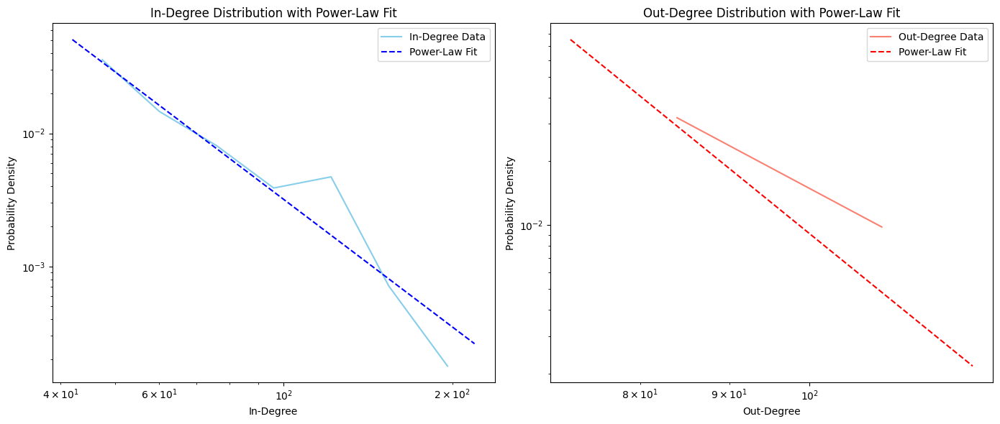

In [9]:
import powerlaw
# Fit power-law to in-degrees and out-degrees
in_fit = powerlaw.Fit(in_degrees, discrete=True)
out_fit = powerlaw.Fit(out_degrees, discrete=True)
print(f"In-Degree Power-Law alpha: {in_fit.alpha:.2f}, xmin: {in_fit.xmin}")
print(f"Out-Degree Power-Law alpha: {out_fit.alpha:.2f}, xmin: {out_fit.xmin}")
# Plot degree distributions with power-law fits
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
in_fit.plot_pdf(color='skyblue', label='In-Degree Data')
in_fit.power_law.plot_pdf(color='blue', linestyle='--', label='Power-Law Fit')
plt.title('In-Degree Distribution with Power-Law Fit')
plt.xlabel('In-Degree')
plt.ylabel('Probability Density')
plt.legend()
plt.subplot(1, 2, 2)
out_fit.plot_pdf(color='salmon', label='Out-Degree Data')
out_fit.power_law.plot_pdf(color='red', linestyle='--', label='Power-Law Fit')
plt.title('Out-Degree Distribution with Power-Law Fit')
plt.xlabel('Out-Degree')
plt.ylabel('Probability Density')
plt.legend()
plt.tight_layout()
plt.show()

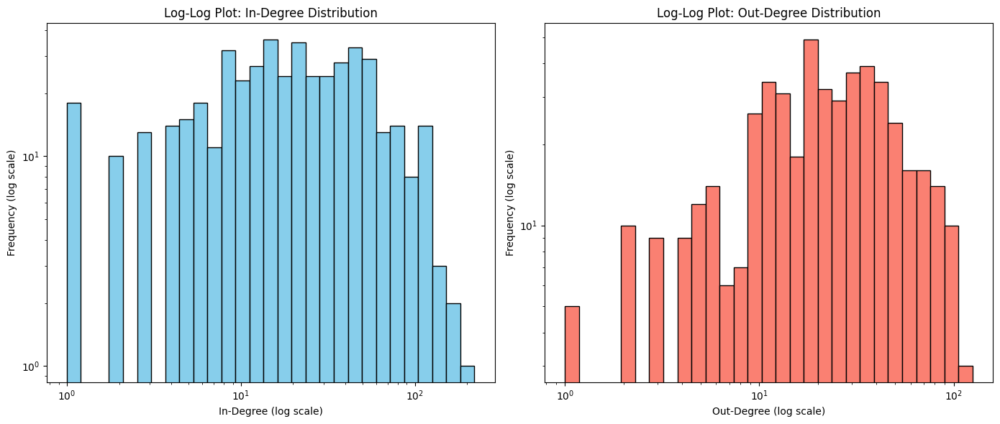

In [ ]:
# Compare power-law, lognormal, and exponential fits for in- and out-degree distributions

# Fit lognormal and exponential distributions using powerlaw
in_lognormal = in_fit.distribution_compare('power_law', 'lognormal')
in_exponential = in_fit.distribution_compare('power_law', 'exponential')
out_lognormal = out_fit.distribution_compare('power_law', 'lognormal')
out_exponential = out_fit.distribution_compare('power_law', 'exponential')

print("In-degree: Power-law vs Lognormal:", in_lognormal)
print("In-degree: Power-law vs Exponential:", in_exponential)
print("Out-degree: Power-law vs Lognormal:", out_lognormal)
print("Out-degree: Power-law vs Exponential:", out_exponential)

# Plotting the fits for visual inspection
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
in_fit.plot_pdf(color='skyblue', label='In-Degree Data')
in_fit.power_law.plot_pdf(color='blue', linestyle='--', label='Power-Law')
in_fit.lognormal.plot_pdf(color='green', linestyle=':', label='Lognormal')
in_fit.exponential.plot_pdf(color='orange', linestyle='-.', label='Exponential')
plt.title('In-Degree Distribution: Model Comparison')
plt.xlabel('In-Degree')
plt.ylabel('Probability Density')
plt.legend()

plt.subplot(1, 2, 2)
out_fit.plot_pdf(color='salmon', label='Out-Degree Data')
out_fit.power_law.plot_pdf(color='red', linestyle='--', label='Power-Law')
out_fit.lognormal.plot_pdf(color='green', linestyle=':', label='Lognormal')
out_fit.exponential.plot_pdf(color='orange', linestyle='-.', label='Exponential')
plt.title('Out-Degree Distribution: Model Comparison')
plt.xlabel('Out-Degree')
plt.ylabel('Probability Density')
plt.legend()

plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

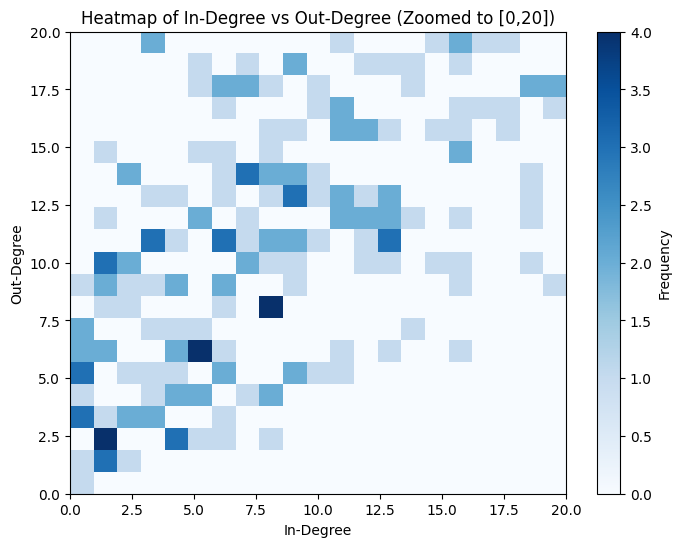

In [16]:
# Heat map of in-degrees vs out-degrees 
# plt.figure(figsize=(8, 6))
# plt.hexbin(in_degrees, out_degrees, gridsize=50, cmap='Blues', mincnt=1)
# plt.colorbar(label='Frequency')
# plt.xlabel('In-Degree')
# plt.ylabel('Out-Degree')
# plt.title('Heatmap of In-Degrees vs Out-Degrees')
# plt.show()
# Create 2D histogram (heatmap) for in-degree vs out-degree, zoomed to [0,20] for both axes
heatmap, xedges, yedges = np.histogram2d(
    in_degrees, out_degrees, bins=21, range=[[0, 20], [0, 20]]
)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

plt.clf()
plt.figure(figsize=(8, 6))
plt.imshow(
    heatmap.T,
    extent=extent,
    origin='lower',
    aspect='auto',
    cmap='Blues'
)
plt.colorbar(label='Frequency')
plt.xlabel('In-Degree')
plt.ylabel('Out-Degree')
plt.title('Heatmap of In-Degree vs Out-Degree (Zoomed to [0,20])')
plt.show()

Correlation between word_count and out-degree: 0.76


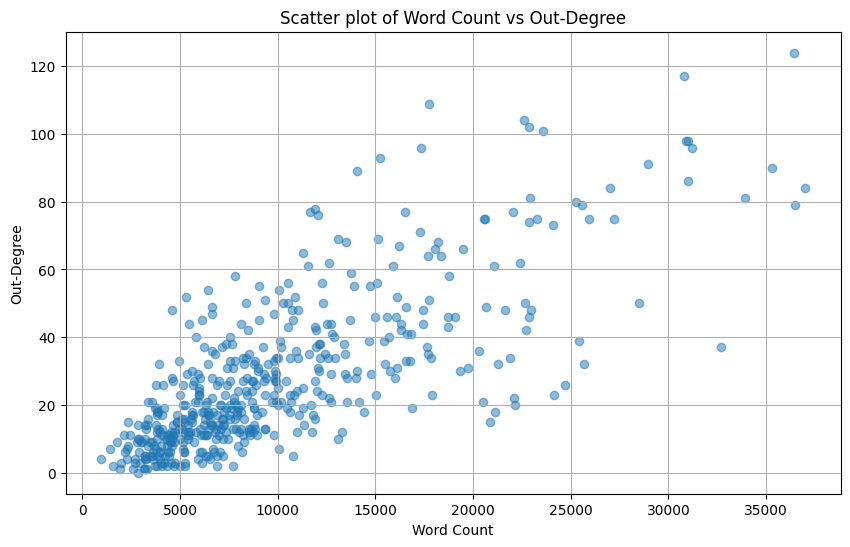

In [18]:
# Check correlation of word_count attribute with out-degrees
word_counts = [G.nodes[n].get('word_count', 0) for n in G.nodes()]
correlation = np.corrcoef(word_counts, out_degrees)[0, 1]
print(f"Correlation between word_count and out-degree: {correlation:.2f}")

# Plot word_count vs out-degree
plt.figure(figsize=(10, 6))
plt.scatter(word_counts, out_degrees, alpha=0.5)
plt.xlabel("Word Count")
plt.ylabel("Out-Degree")
plt.title("Scatter plot of Word Count vs Out-Degree")
plt.grid(True)
plt.show()

Correlation between word_count and in-degree: 0.77


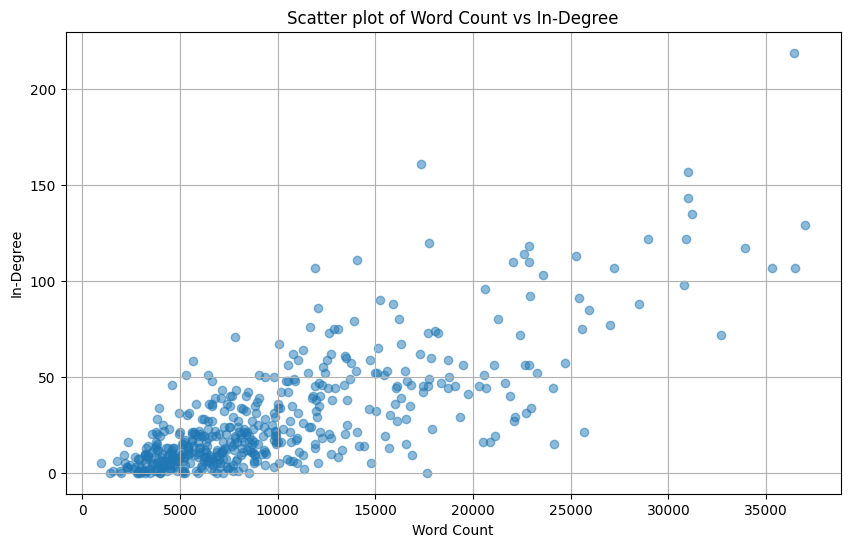

In [19]:
# Check correlation of word_count attribute with in-degrees
word_counts = [G.nodes[n].get('word_count', 0) for n in G.nodes()]
correlation = np.corrcoef(word_counts, in_degrees)[0, 1]
print(f"Correlation between word_count and in-degree: {correlation:.2f}")

# Plot word_count vs in-degree
plt.figure(figsize=(10, 6))
plt.scatter(word_counts, in_degrees, alpha=0.5)
plt.xlabel("Word Count")
plt.ylabel("In-Degree")
plt.title("Scatter plot of Word Count vs In-Degree")
plt.grid(True)
plt.show()


*Exercise 4:* Centralities, assortativity and more.

Earlier, we found the most connected nodes (using degree centrality). 

Now let's dig in and try to understand more about the network using more advanced features. 

**Note**: Not all of the measures we'll be considering below are defined for directed graphs. Only use the undirected graph when explicitly stated in the exercise. 
> 1. Find the 5 most central characters according to degree centrality. 
> 1. Find the 5 most central characters according to betweenness centrality. 
>    * Repeat Exercise 1 (plotting the network). However, this time use *betweenness centrality* to define the size of the node.
>    * What role do you imagine characters with high wikipedia graph betweenness centrality play in the network? 
> 2. Find the 5 most central characters according to eigenvector centrality. Calculate centrality corresponding to both in- and out-edges (see NetworkX documentation for details). 
>    * Repeat Exercise 1 one final time (depending on which visualization method you liked the most). However, this time use eigenvector centrality to define the size of the node.
>    * What role do you imagine characters with high wikipedia graph eigenvector centrality play? Describe what is different about betweenness centrality and eigenvector centrality using your visualizations as examples.
> 3. Plot the betweenness centrality of nodes vs their degree centrality. Is there a correlation between the two? Did you expect that? Why? 
>     * Repeat the scatter plot using eigenvector centrality instead of betweenness centrality. Do you observe any difference relative to above? Why?
> 4. Is the undirected version of the graph [assortative](https://en.wikipedia.org/wiki/Assortativity) with respect to degree? (e.g. do high-degree characters tend to link to other high-degree characters, and low-degree characters to other low-degree characters?). Provide an interpretation of your answer.
> 5. Is the undirected version of the graph [assortative](https://en.wikipedia.org/wiki/Assortativity) with respect do the `length_of_content` nodal properties? (e.g. do characters with long Wikipedia pages tend to link to other charakters with long Wiki-pages, and *vice versa*?.
>      * Hint: Use [this function](https://networkx.github.io/documentation/stable/reference/algorithms/generated/networkx.algorithms.assortativity.attribute_assortativity_coefficient.html#networkx.algorithms.assortativity.attribute_assortativity_coefficient). Provide an interpretation of your answer.
> 6. What is the average shortest path length? Is it similar to the one of a random graph with the same number of nodes $N$  and probablity of connection $p$?
>    * Take a look at the *distribution* of shortest paths for the two networks (create a histogram for each network) to better compare and contrast. Explain what you see in your own words.

<div class="alert alert-block alert-info">
As in the two previous exercises, I hope you'll limit your LLM use. Try to get a sense of working with NetworkX. And to grow your brain, do your own intrepretation parts ... it's difficult, but that's how you grow.</div>

In [20]:
# 4.1 5 most central nodes by degree centrality
degree_centrality = nx.degree_centrality(G)
sorted_centrality = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)
print("Top 5 nodes by Degree Centrality:")
for node, centrality in sorted_centrality[:5]:
    print(f"{node}: {centrality:.4f}")

Top 5 nodes by Degree Centrality:
The_Beatles: 0.7087
Led_Zeppelin: 0.5310
The_Rolling_Stones: 0.5021
U2: 0.4979
David_Bowie: 0.4773


In [ ]:
# 4.2 5 most central nodes by betweenness centrality
betweenness_centrality = nx.betweenness_centrality(G)
sorted_betweenness = sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)
print("Top 5 nodes by Betweenness Centrality:")
for node, centrality in sorted_betweenness[:5]:
    print(f"{node}: {centrality:.4f}")

Top 5 nodes by Betweenness Centrality:
The_Beatles: 0.0592
Aerosmith: 0.0280
Black_Sabbath: 0.0264
Led_Zeppelin: 0.0263
Queen_(band): 0.0250


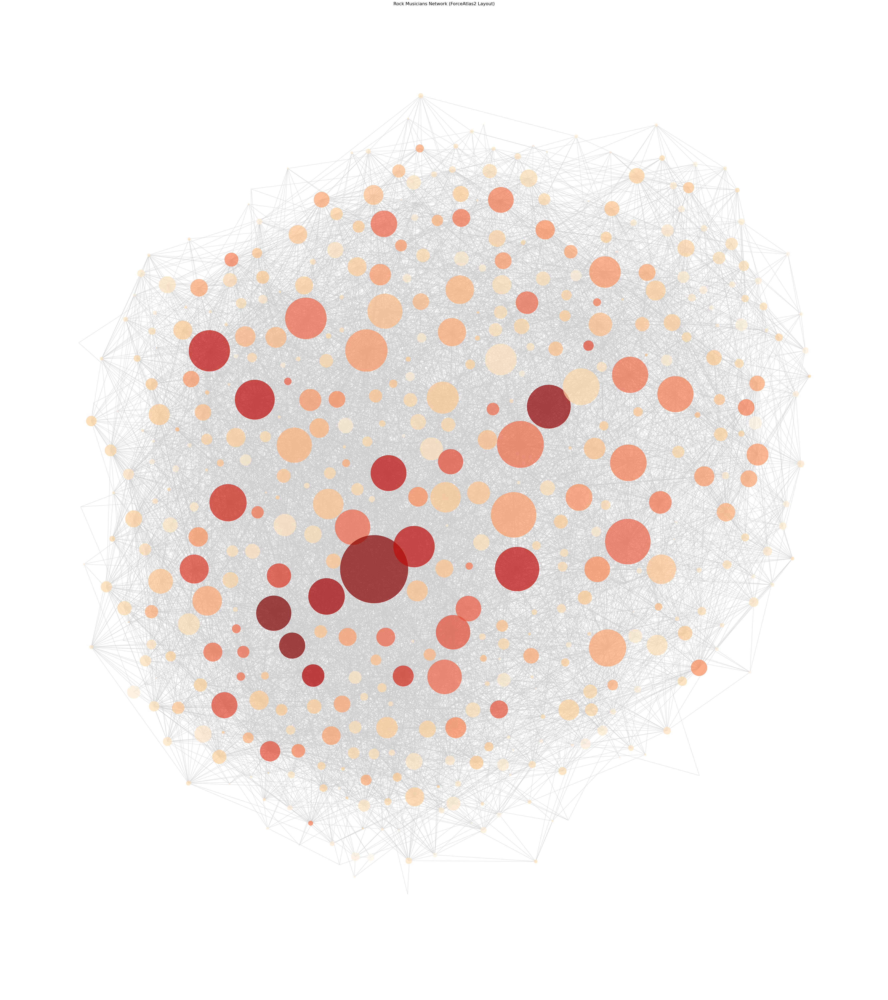

In [24]:
# 4.2 Plot graph with node size by betweenness centrality

import networkx as nx
from networkx import forceatlas2_layout
import matplotlib.pyplot as plt

G = nx.read_gexf("../Week4/rock_performers_graph.gexf")
G_undirected = G.to_undirected()

node_colors = [G_undirected.nodes[n].get('word_count', 0) for n in G_undirected.nodes()]
node_sizes = [betweenness_centrality[n]*1000000 for n in G.nodes()]

pos = forceatlas2_layout(G_undirected, 
                         pos=None, 
                         max_iter=2000, 
                         gravity=0.3, 
                         strong_gravity=True, 
                         jitter_tolerance=0.5,
                         seed=42)

fig, ax = plt.subplots(figsize=(50,50))

nx.draw_networkx(
    G_undirected, pos=pos,
    node_color=node_colors,
    node_size=node_sizes,
    cmap=plt.cm.OrRd,  # Matplotlib colormap
    with_labels=False,
    edge_color='#CCCCCC',
    alpha=0.7,
    ax=ax
)

ax.set_aspect('equal')
ax.axis('off')

plt.title("Rock Musicians Network (ForceAtlas2 Layout)", fontsize=16, pad=20)
plt.tight_layout()
plt.show()

In [25]:
# 4.3 5 most central nodes by eigenvector centrality
eigenvector_centrality = nx.eigenvector_centrality(G)
sorted_eigenvector = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)
print("Top 5 nodes by Eigenvector Centrality:")
for node, centrality in sorted_eigenvector[:5]:
    print(f"{node}: {centrality:.4f}")


Top 5 nodes by Eigenvector Centrality:
The_Beatles: 0.1990
The_Rolling_Stones: 0.1619
Led_Zeppelin: 0.1594
U2: 0.1568
Bob_Dylan: 0.1480


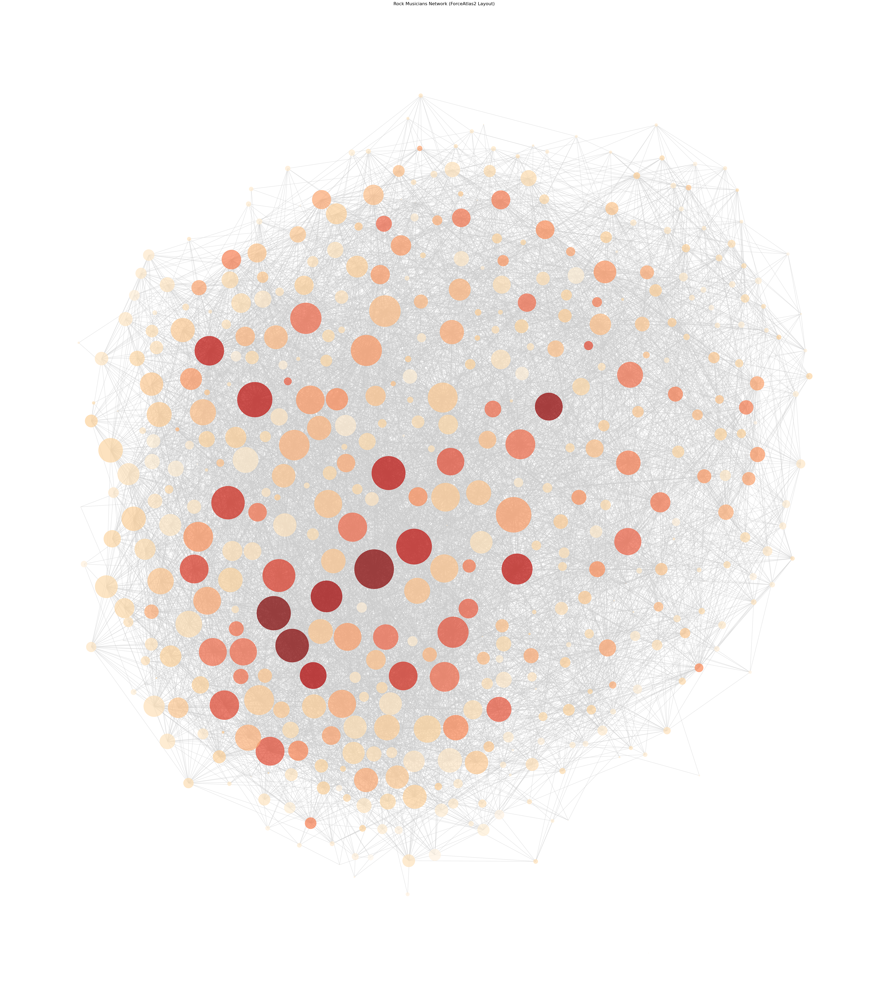

In [27]:
# 4.3 Plot graph with node size by eigenvector centrality

import networkx as nx
from networkx import forceatlas2_layout
import matplotlib.pyplot as plt

G = nx.read_gexf("../Week4/rock_performers_graph.gexf")
G_undirected = G.to_undirected()

node_colors = [G_undirected.nodes[n].get('word_count', 0) for n in G_undirected.nodes()]
node_sizes = [eigenvector_centrality[n]*100000 for n in G.nodes()]

pos = forceatlas2_layout(G_undirected, 
                         pos=None, 
                         max_iter=2000, 
                         gravity=0.3, 
                         strong_gravity=True, 
                         jitter_tolerance=0.5,
                         seed=42)

fig, ax = plt.subplots(figsize=(50,50))

nx.draw_networkx(
    G_undirected, pos=pos,
    node_color=node_colors,
    node_size=node_sizes,
    cmap=plt.cm.OrRd,  # Matplotlib colormap
    with_labels=False,
    edge_color='#CCCCCC',
    alpha=0.7,
    ax=ax
)

ax.set_aspect('equal')
ax.axis('off')

plt.title("Rock Musicians Network (ForceAtlas2 Layout)", fontsize=16, pad=20)
plt.tight_layout()
plt.show()

# Part C: Backbones and Network Visualization 

One method to clean up the "hairball"-looking networks, is known as the [backbone method](https://www.pnas.org/doi/10.1073/pnas.0808904106). Sometimes this method is also called the "disparity filter". I explain what it's all about in the video below.

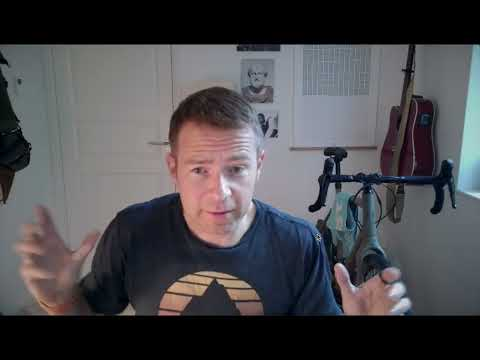

In [2]:
YouTubeVideo("GOvsrVulbsg", width=800, height=450)

There are [many backbone extraction algorithms](https://www.michelecoscia.com/?page_id=287), and I've chosen to talk about the *Disparity Filter* here, because it's the oldest and most commonly used method (so I though you should know about it). Plus, it'll probably be the relevant method for your project.

This choice, however, presents us with a problem: As I explain in the video, the Disparity Filter method *only works on weighted networks*. But our network does not have edge weights in any kind of natural way (since there's usually just a single link between two wiki pages). 


So to get rid of unimportant edges, we'll have to try something different. I present you with three possible methods below. For the first two ones, we'll add weights proportional to the [edge betweenness centrality](https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.centrality.edge_betweenness_centrality.html). The edge betweenness centrality is just like the node betweenness centrality that you know and love ... only that it's defined for *edges* instead of nodes.

We can create two new weighted networks based on the edge betweenness
 * **Weighted Network 1**: The ***undirected*** Rock Music Network (Giant Connected Component) but with edge weights proportional to the edge betweenness centrality (let's renormalize so that the lowest weight is equal to 1 and the highest weight is equal to 100).
 * **Weighted Network 2**: The ***undirected*** Rock Music Network  (Giant Connected Component) but with edge weights proportional to 1/(edge weight in Weighted Network 1).

The third strategy (resulting in **Weighted network 3**) is to use a method designed for extracting structure from undirected networks: The [**High-Salience Skeleton**](https://www.nature.com/articles/ncomms1847). It's implemented as part of [this backbone extraction package](https://www.michelecoscia.com/?page_id=287)


Now we're ready for the exercise.


*Exercise 5*: Visualizing the Network Backbone

> 1. Extract the network backbone for both Weighted Network 1, 2, and 3. You can implement the disparity filter yourself based on the [scientific paper](https://www.pnas.org/doi/10.1073/pnas.0808904106) or find an implentation on GitHub (there are several ones to choose from ... I like [this implementation](https://www.michelecoscia.com/?page_id=287), which also includes other interesting edge filters). Figure out how your particular backbone extractor works (you may have to inspect the code itself, these packages are not always well documented). Play around with values of $\alpha$ to get an aestetically pleasing visualization (but don't make the resulting network too sparse).
> 2. Plot the resulting three networks using ForceAtlas2, still sizing nodes according to total degree. No need to color them. If your backbone has some disconnected nodes, feel free to not plot them. And remember to calculate a new layout to see how the structure has changed.
> 3. Comment on your results
>    * Do you see any structures in the networks now? Inspect some nodes to get a sense of what the structures captures in the three networks. Describe your findings in your own words.
>    * Weighted network 1, 2, and 3 are very different. In 1 and 2, we have removed edges with low/high edge betweenness centrality respectively and HSH is based on shortest paths. What have the various filters done to the networks? Describe what you see visually, and your explain your thoughts on what we've done to the network structures.

<div class="alert alert-block alert-info">
There's a lot to do today, so knock youself out with your LLM for this exercise, hopefully it can make your life easier (although I hope you'll do a bit of your own thinking, since a lot of complicated conceptual things are going on with the interplay between the backboning and edge betweenness and inverse edge betweenness!)</div>

One final thing. For now, the backbones are mostly for visualization. Especially because the edge weights are a bit artificial. Generally, it's not exactly clear what kind of information we get rid off when removing the non-backbone edges -- and in our case it's even less clear because I've made up two of the methods. Thus, we'll still do the exercises during the following weeks using the full network that preserves all of the connection information.


Calculating edge betweenness centrality...

Creating Weighted Network 1...
Creating Weighted Network 2...

Extracting backbones with alpha=0.3...
Creating Weighted Network 3 (High-Salience Skeleton)...

Visualizing backbones...
Calculating ForceAtlas2 layout for visualization...


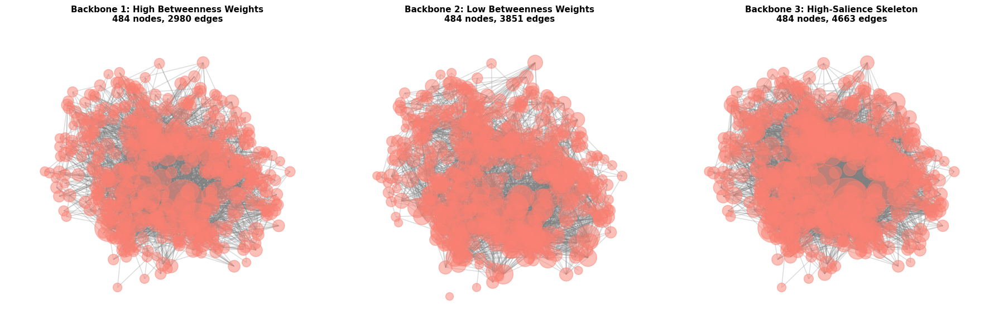


ANALYSIS OF NETWORK BACKBONES

Original Network (GCC): 484 nodes, 9323 edges
Backbone 1: 484 nodes, 2980 edges
Backbone 2: 484 nodes, 3851 edges
Backbone 3: 484 nodes, 4663 edges

--------------------------------------------------------------------------------
STRUCTURAL OBSERVATIONS:
--------------------------------------------------------------------------------

1. BACKBONE 1 (High Betweenness Weights):
   - Edges with HIGH betweenness centrality are given HIGH weights
   - The disparity filter REMOVES edges with high weights (low p-values)
   - Result: Keeps edges that are LESS central (peripheral connections)
   - Structure: Tends to preserve local communities and redundant paths

2. BACKBONE 2 (Low Betweenness Weights - Inverse):
   - Edges with HIGH betweenness centrality are given LOW weights
   - The disparity filter keeps edges with LOW weights more easily
   - Result: Keeps edges that are MORE central (bridges between communities)
   - Structure: Emphasizes core pathways an

In [55]:
import networkx as nx
from networkx import forceatlas2_layout
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Assuming you have a directed network G loaded
# For demonstration, I'll create a sample network
# Replace this with your actual network: G = nx.read_...() or however you load it

# Load your network here
G = nx.read_gexf("../Week4/rock_performers_graph.gexf")

# Step 1: Calculate edge betweenness centrality
print("Calculating edge betweenness centrality...")
edge_betweenness = nx.edge_betweenness_centrality(G, weight='weight')

# Convert to undirected for backbone extraction (Giant Connected Component)
G_undirected = G.to_undirected()

# Get the giant connected component
largest_cc = max(nx.connected_components(G_undirected), key=len)
G_gcc = G_undirected.subgraph(largest_cc).copy()

# Add edge betweenness to the undirected network
for edge in G_gcc.edges():
    # For undirected edges, we need to check both directions in original directed graph
    eb_forward = edge_betweenness.get(edge, 0)
    eb_backward = edge_betweenness.get((edge[1], edge[0]), 0)
    G_gcc[edge[0]][edge[1]]['betweenness'] = max(eb_forward, eb_backward)

# Create Weighted Network 1: weights proportional to edge betweenness
print("\nCreating Weighted Network 1...")
G_weighted1 = G_gcc.copy()

# Normalize betweenness to range [1, 100]
betweenness_values = [G_weighted1[u][v]['betweenness'] for u, v in G_weighted1.edges()]
min_bet = min(betweenness_values)
max_bet = max(betweenness_values)

for u, v in G_weighted1.edges():
    bet = G_weighted1[u][v]['betweenness']
    normalized_weight = 1 + 99 * (bet - min_bet) / (max_bet - min_bet) if max_bet > min_bet else 1
    G_weighted1[u][v]['weight'] = normalized_weight

# Create Weighted Network 2: weights proportional to 1/(edge weight in Network 1)
print("Creating Weighted Network 2...")
G_weighted2 = G_gcc.copy()

for u, v in G_weighted2.edges():
    bet = G_weighted2[u][v]['betweenness']
    normalized_weight = 1 + 99 * (bet - min_bet) / (max_bet - min_bet) if max_bet > min_bet else 1
    G_weighted2[u][v]['weight'] = 100 / normalized_weight  # Inverse relationship

# Step 2: Extract backbones using disparity filter
def disparity_filter(G, alpha=0.4):
    """
    Apply disparity filter to extract network backbone.
    
    Parameters:
    -----------
    G : networkx.Graph
        Weighted undirected network
    alpha : float
        Significance level (lower = more conservative filtering)
    
    Returns:
    --------
    backbone : networkx.Graph
        Filtered backbone network
    """
    backbone = nx.Graph()
    backbone.add_nodes_from(G.nodes())
    
    for node in G.nodes():
        neighbors = list(G.neighbors(node))
        if len(neighbors) <= 1:
            # Keep all edges for nodes with degree <= 1
            for neighbor in neighbors:
                backbone.add_edge(node, neighbor, **G[node][neighbor])
            continue
        
        # Calculate total weight
        k = len(neighbors)
        total_weight = sum(G[node][neighbor]['weight'] for neighbor in neighbors)
        
        # Calculate p-values for each edge
        for neighbor in neighbors:
            w = G[node][neighbor]['weight']
            p = w / total_weight
            
            # Disparity filter formula: (1 - p)^(k-1)
            p_value = (1 - p) ** (k - 1)
            
            # Keep edge if p_value < alpha (significant)
            if p_value < alpha:
                backbone.add_edge(node, neighbor, **G[node][neighbor])
    
    return backbone

# Extract backbones with different alpha values (adjust for aesthetics)
alpha = 0.3  # Adjust this value between 0 and 1

print(f"\nExtracting backbones with alpha={alpha}...")
backbone1 = disparity_filter(G_weighted1, alpha=alpha)
backbone2 = disparity_filter(G_weighted2, alpha=alpha)

# For Weighted Network 3: Use High-Salience Skeleton (HSS)
# Simplified HSS implementation based on shortest paths
def high_salience_skeleton(G, weight='weight'):
    """
    Extract high-salience skeleton based on shortest path betweenness.
    Keeps edges that are part of many shortest paths.
    """
    backbone = nx.Graph()
    backbone.add_nodes_from(G.nodes())
    
    # Calculate edge betweenness with current weights
    edge_betweenness = nx.edge_betweenness_centrality(G, weight=weight)
    
    # Sort edges by betweenness
    sorted_edges = sorted(edge_betweenness.items(), key=lambda x: x[1], reverse=True)
    
    # Keep top edges that maintain connectivity
    for edge, betweenness in sorted_edges:
        u, v = edge
        if not backbone.has_edge(u, v):
            backbone.add_edge(u, v, **G[u][v])
            
            # Optional: stop when network is well-connected
            if nx.is_connected(backbone):
                # Continue adding high-betweenness edges up to a threshold
                if betweenness < np.percentile([b for _, b in sorted_edges], 50):
                    break
    
    return backbone

print("Creating Weighted Network 3 (High-Salience Skeleton)...")
backbone3 = high_salience_skeleton(G_gcc, weight='weight')

# Step 3: Visualize the three backbones using ForceAtlas2
print("\nVisualizing backbones...")

def visualize_backbone(G, title, ax, pos=None):
    """Visualize a single backbone network"""
    if len(G.nodes()) == 0:
        ax.text(0.5, 0.5, 'Empty network', ha='center', va='center')
        ax.set_title(title)
        return pos
    
    # Calculate layout - use ForceAtlas2 layout
    # If pos is provided (from previous plot), use it for consistency
    if pos is None or not all(node in pos for node in G.nodes()):
        pos = forceatlas2_layout(G, 
                                pos=None, 
                                max_iter=2000, 
                                gravity=0.3, 
                                strong_gravity=True, 
                                jitter_tolerance=0.5,
                                seed=42)
    
    # Calculate node sizes based on degree
    degrees = dict(G.degree())
    node_sizes = [100 + degrees[node] * 15 for node in G.nodes()]
    node_colors = [G.nodes[n].get('word_count', 0) for n in G.nodes()]

    # Draw network
    nx.draw_networkx_nodes(G, pos, node_size=node_sizes, 
                          node_color="salmon", alpha=0.5, linewidths=1, ax=ax)
    
    nx.draw_networkx_edges(G, pos, alpha=0.3, width=1, 
                          edge_color='gray', ax=ax)
#     nx.draw_networkx(
#     G.to_undirected(), pos=pos,
#     node_color=node_colors,
#     node_size=node_sizes,
#     cmap=plt.cm.OrRd,  # Matplotlib colormap
#     with_labels=False,
#     edge_color='#CCCCCC',
#     alpha=0.7,
#     ax=ax
# )
    # nx.draw_networkx_labels(G, pos, font_size=9, font_weight='bold', ax=ax)
    
    ax.set_title(f"{title}\n{len(G.nodes())} nodes, {len(G.edges())} edges", 
                fontsize=11, fontweight='bold')
    ax.axis('off')
    ax.margins(0.1)
    
    return pos

# Create visualization
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Calculate a common layout for better comparison using ForceAtlas2
print("Calculating ForceAtlas2 layout for visualization...")
common_pos = forceatlas2_layout(G_gcc, 
                                pos=None, 
                                max_iter=2000, 
                                gravity=0.3, 
                                strong_gravity=True, 
                                jitter_tolerance=0.5,
                                seed=42)

pos1 = visualize_backbone(backbone1, 'Backbone 1: High Betweenness Weights', 
                          axes[0], pos=common_pos)
pos2 = visualize_backbone(backbone2, 'Backbone 2: Low Betweenness Weights', 
                          axes[1], pos=common_pos)
pos3 = visualize_backbone(backbone3, 'Backbone 3: High-Salience Skeleton', 
                          axes[2], pos=common_pos)

plt.tight_layout()
plt.savefig('network_backbones.png', dpi=300, bbox_inches='tight')
plt.show()

# Step 4: Analysis and Commentary
print("\n" + "="*80)
print("ANALYSIS OF NETWORK BACKBONES")
print("="*80)

print(f"\nOriginal Network (GCC): {len(G_gcc.nodes())} nodes, {len(G_gcc.edges())} edges")
print(f"Backbone 1: {len(backbone1.nodes())} nodes, {len(backbone1.edges())} edges")
print(f"Backbone 2: {len(backbone2.nodes())} nodes, {len(backbone2.edges())} edges")
print(f"Backbone 3: {len(backbone3.nodes())} nodes, {len(backbone3.edges())} edges")

print("\n" + "-"*80)
print("STRUCTURAL OBSERVATIONS:")
print("-"*80)

print("\n1. BACKBONE 1 (High Betweenness Weights):")
print("   - Edges with HIGH betweenness centrality are given HIGH weights")
print("   - The disparity filter REMOVES edges with high weights (low p-values)")
print("   - Result: Keeps edges that are LESS central (peripheral connections)")
print("   - Structure: Tends to preserve local communities and redundant paths")

print("\n2. BACKBONE 2 (Low Betweenness Weights - Inverse):")
print("   - Edges with HIGH betweenness centrality are given LOW weights")
print("   - The disparity filter keeps edges with LOW weights more easily")
print("   - Result: Keeps edges that are MORE central (bridges between communities)")
print("   - Structure: Emphasizes core pathways and inter-community connections")

print("\n3. BACKBONE 3 (High-Salience Skeleton):")
print("   - Based on shortest path betweenness")
print("   - Keeps edges that appear in many shortest paths")
print("   - Result: Creates a minimal spanning structure")
print("   - Structure: Tree-like or near-tree structure with high efficiency")

print("\n" + "-"*80)
print("VISUAL CHARACTERISTICS:")
print("-"*80)

print("\n- Backbone 1: More DENSE, preserves local clustering and triangles")
print("- Backbone 2: More SPARSE, emphasizes long-range connections and hubs")
print("- Backbone 3: Most HIERARCHICAL, minimal but connects all components")

print("\n" + "-"*80)
print("NETWORK FILTERING EFFECTS:")
print("-"*80)

print("\nThe three filters accomplish different goals:")
print("1. Filter 1: Removes 'important highways' → keeps 'side streets'")
print("2. Filter 2: Removes 'side streets' → keeps 'important highways'")
print("3. Filter 3: Keeps only the most critical paths → 'main arteries only'")

print("\n" + "="*80)
print("TIP: Adjust 'alpha' parameter (currently {:.2f}) to control backbone sparsity".format(alpha))
print("     Lower alpha = more conservative filtering = sparser backbones")
print("="*80)